## DEMO: 3D particle in a box

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from ipywidgets.widgets import interact, interactive

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

### This works only in colab
from google.colab import output
output.enable_custom_widget_manager()

- Set atomic units: $h=1, m=1$

$$\psi_n(x)=\sqrt{\frac{2}{L}}sin \frac{n\pi x}{L}$$

$$E_n = \frac{n^2 h^2}{8m L^2}$$

In [4]:
h, m = 1, 1
hbar = h/(2*np.pi)

def Epib1d(n=1, L=1):

        En = (n**2 * np.pi**2 * hbar**2) / (2 * m * L**2)

        return En


def psi(x, n=1, L=1):

        fn = np.sqrt(2/L)*np.sin(n*np.pi*x/L)

        return fn

In [5]:
def psi_reg(x, y, z, q_nx=1, q_ny=1, q_nz=1, lx=1, ly=1, lz=1):
  '''Numeric representation of the normalized 3D PIB wavefunction.
  Args:
    x, y, z (float or array): Cartesian spatial values.
    q_nx, q_ny, q_nz (int): Quantum numbers specifying state.
    lx, ly, lz (int): Box dimensions in Bohr.
  Returns:
    Wavefunction evaulated at a point or array if input x, y, z are arrays.
  '''

  psix = np.sin((q_nx*np.pi*x)/lx)
  psiy = np.sin((q_ny*np.pi*y)/ly)
  psiz = np.sin((q_nz*np.pi*z)/lz)

  wvfn = np.sqrt(8/(lx*ly*lz)) * psix * psiy * psiz

  return wvfn


def psi_ener(nx, ny, nz, lx, ly, lz):
  '''Calculates energy of 3D PIB state.
  Args:
    qnx, qny, qnz (int): Quantum numbers specifying state.
    lx, ly, lz (int): Box dimensions in Bohr.
  Returns:
    Float energy value in Ha.
  '''

  e_level = (4*np.pi**2/8)*((nx/lx)**2 + (ny/ly)**2 + (nz/lz)**2)

  return np.round(e_level, decimals=6)

In [6]:
def pib3d_plotly(nx=1, ny=1, nz=1, lx=10, ly=10, lz=10):
  '''Displays and saves isosurface of 3D PIB wavefunction.
  Args:
      nx_val, ny_val, nz_val (int): Quantum numbers specifying state.
      lx, ly, lz (int): Box dimensions in Bohr.
      psi_square (bool): Calculate prob. density (true) or wavefunction (false).
      plot_save (bool): Save a .png file of display.
  '''
  # construct 3d grid of points
  nx_p, ny_p, nz_p = 7 * lx, 7 * ly, 7 * lz
  xp, yp, zp       = np.linspace(0, lx, nx_p), np.linspace(0, ly, ny_p), np.linspace(0, lz, nz_p)
  X, Y, Z          = np.meshgrid(xp, yp, zp, indexing='ij')
  psi              = psi_reg(X, Y, Z, nx, ny, nz, lx, ly, lz)
  psi2             = psi**2
  mean_dens        = psi2.mean()

  figure = go.Figure(data=go.Isosurface(
  x=X.flatten(),
  y=Y.flatten(),
  z=Z.flatten(),
  value=psi2.flatten(), # pis or psi2
  colorscale='BlueRed',
  isomin= -mean_dens,
  isomax=  mean_dens,
  surface_count=2,
  showscale=False,
  caps=dict(x_show=False, y_show=False, z_show=False)
  ))

  figure.update_layout(scene = dict(
                  xaxis_title='x',
                  yaxis_title='y',
                  zaxis_title='z',
                  aspectmode='data'),
                  width=800,
                  height=500,
                  title_text=f'Prob. Den., isovalue = {mean_dens:.4f}')

  figure.show()

In [9]:
interact(pib3d_plotly, nx=(1,10), ny=(1,10), nz=(1,10), lx=(1,10), ly=(1,10), lz=(1,10))

interactive(children=(IntSlider(value=1, description='nx', max=10, min=1), IntSlider(value=1, description='ny'…

<function __main__.pib3d_plotly(nx=1, ny=1, nz=1, lx=10, ly=10, lz=10)>

In [11]:
def plot_energy_levels(nx_max=10, ny_max=10, nz_max=10, Lx=1, Ly=1, Lz=1):

    fig, ax = plt.subplots(figsize=(8, 6))

    for nx in range(1, nx_max+1):

        Enx = Epib1d(nx, Lx)
        ax.hlines(Enx, 0.6, 1, colors='blue', linewidth=2)

    for ny in range(1, ny_max+1):

        Eny = Epib1d(ny, Ly)
        ax.hlines(Eny, 1.1, 1.5, colors='green', linewidth=2)

    for nz in range(1, nz_max+1):

        Enz = Epib1d(nz, Lz)
        ax.hlines(Enz, 1.6, 2.0, colors='yellow', linewidth=2)


    E_max =     Epib1d(nx_max+1, Lx)+Epib1d(ny_max+1, Ly)+Epib1d(nz_max+1, Lz)
    ax.set_xlim(0.5, 2.1)
    ax.set_ylim(0, E_max)
    ax.set_xlabel("Particle in a 3d Box")
    ax.set_ylabel("Energy")
    ax.set_title(f"Energy Levels of a 3D Quantum Particle in a Box E={E_max:2f}")
    ax.axes.get_xaxis().set_visible(False)

    plt.tight_layout()
    plt.show()

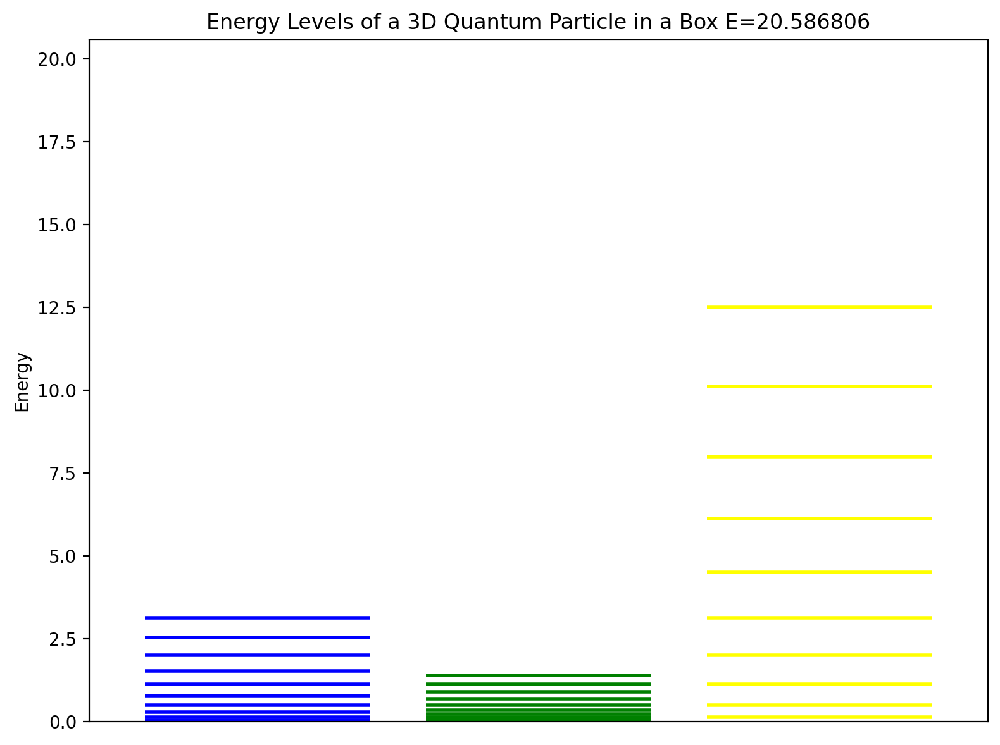

In [12]:
plot_energy_levels(nx_max=10, ny_max=10, nz_max=10, Lx=2, Ly=3, Lz=1)